In [58]:
from sklearn.manifold import MDS
from matplotlib import pyplot as plt
import pandas as pd

def read_clean_data(filename):
    d = pd.read_csv(filename)[['title','artist','year','bpm', 'nrgy', 'dnce', 'dB','live', 'val', 'dur','acous', 'spch','pop']]
    d = d.rename({'bpm':'tempo','nrgy':'energy','dnce':'danceability','dB':'loudness','live':'liveness',
                  'val':'valence','dur':'duration','acous':'acousticness','spch':'speechiness','pop':'popularity'},
                 axis = 1)
    d['decade'] = filename[2:4] + 's'
    return d

In [59]:
filenames = ['1950.csv','1980.csv','2010.csv']

df = pd.concat([read_clean_data(i) for i in filenames]).reset_index()

df_id = df[["title","artist"]]

df = df.iloc[:,4:]

x = df.loc[:, df.columns[:-1]].values
y = df.loc[:,['decade']].values

In [60]:
df.iloc[:, :-1] = (df.iloc[:, :-1]-df.iloc[:, :-1].mean()) / df.iloc[:, :-1].std(ddof = 1)

In [62]:
targets = ['50s',  '80s', '10s']
colors = ['tab:blue', 'tab:orange', 'tab:green',]
    
x = pd.DataFrame(df.loc[:, df.columns[:-1]].values)
y = df.loc[:,['decade']].values.flatten()

def get_mds(maxiter):
    mds = MDS(random_state=0, max_iter=maxiter, eps = 1e-9)

    Xtrans = mds.fit_transform(x)

    toplot = pd.DataFrame({"PC1":[i[0] for i in Xtrans],"PC2":[i[1] for i in Xtrans],"key":y})
    
    
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(1,1,1) 
    ax.set_xlabel("MDS1") 
    ax.set_xlim(-10, 10)
    ax.set_ylim(-10, 10)
    ax.set_ylabel("MDS2") 
    ax.set_title("2 dimensional MDS ITER: " + str(maxiter) )
    
    for target, color in zip(targets,colors):
        indicesToKeep = toplot['key'] == target
        ax.scatter(toplot.loc[indicesToKeep, 'PC1']
                    , toplot.loc[indicesToKeep, 'PC2']
                    , c = color
                    , s = 200
                    , alpha = 0.6)
    ax.legend(targets)
    ax.grid()
    
    plt.savefig('images/' + str(maxiter) + '.png')

/var/folders/3n/qb9qrmdn45q_rjlp5x6g7k5c0000gn/T/ipykernel_6525/2546301804.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(10, 10))


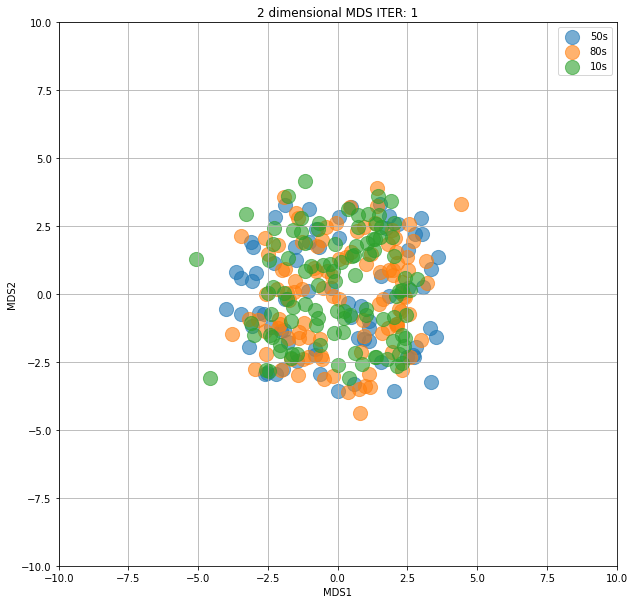

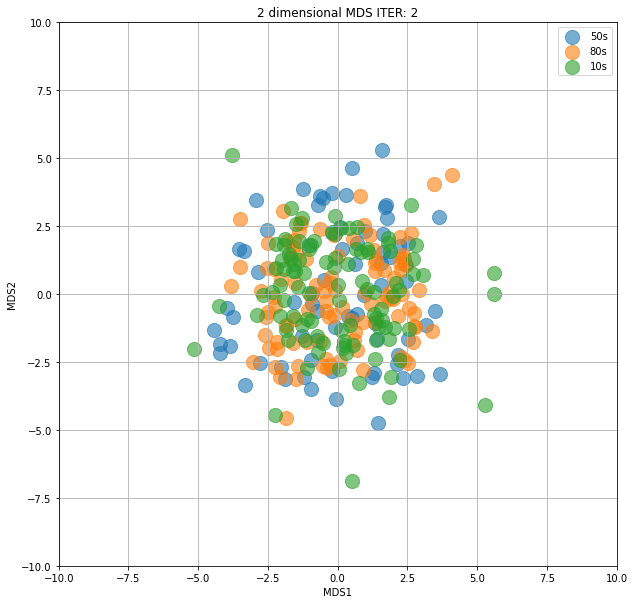

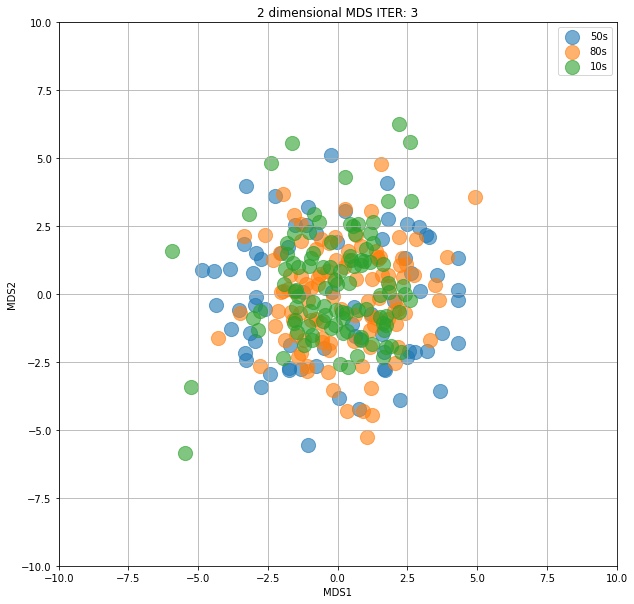

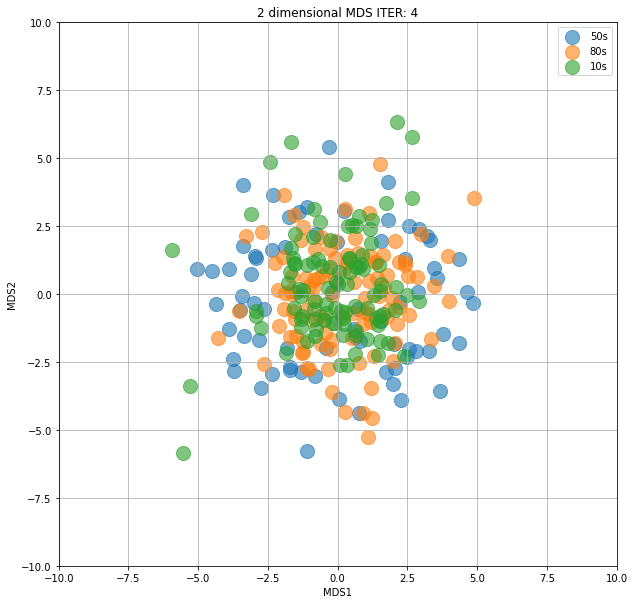

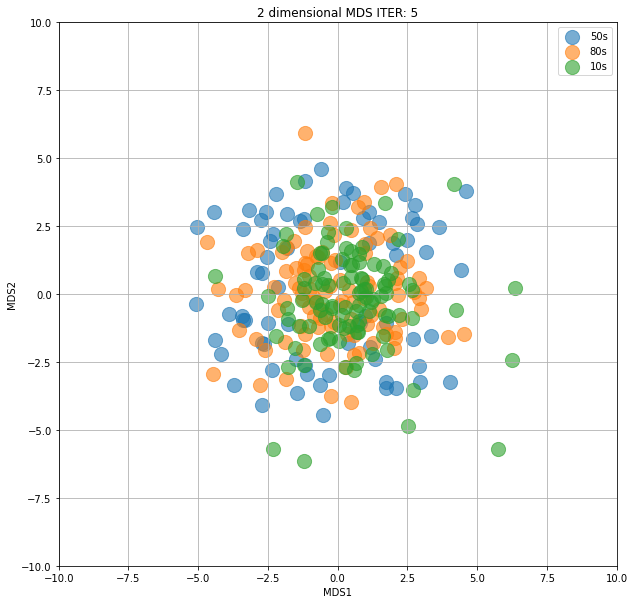

...

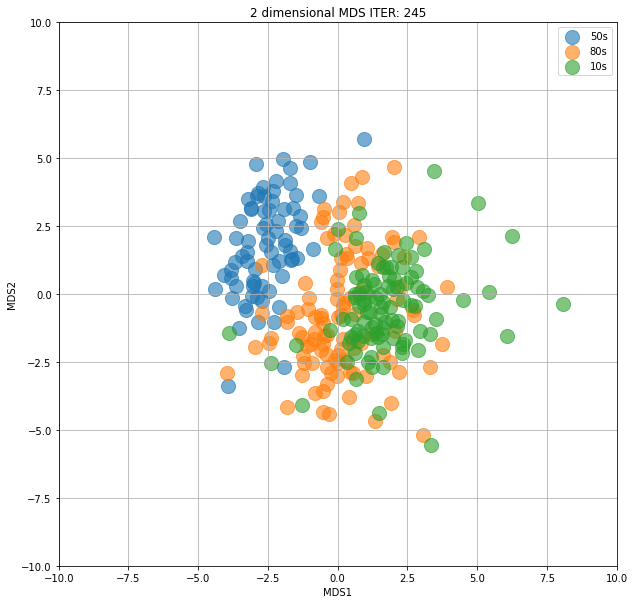

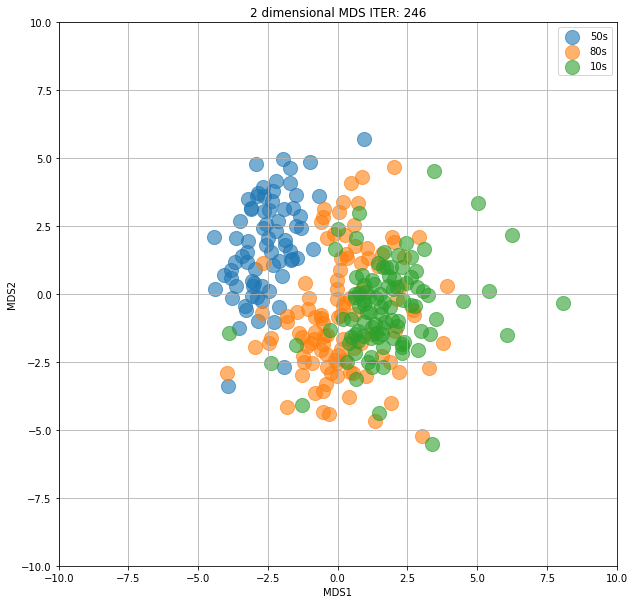

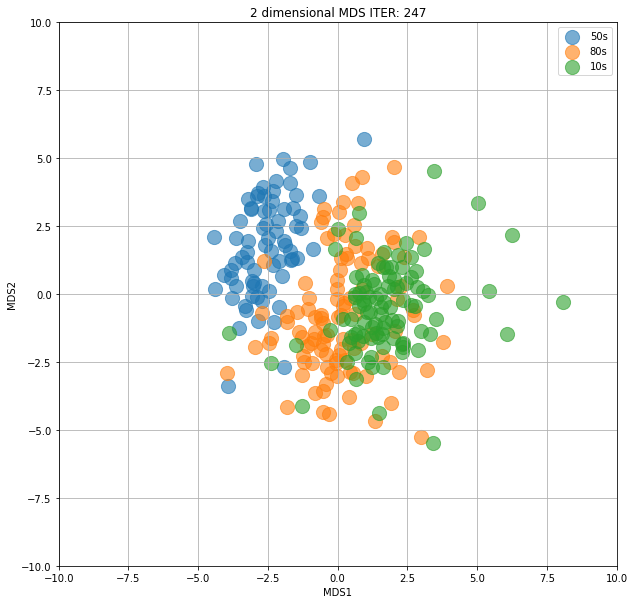

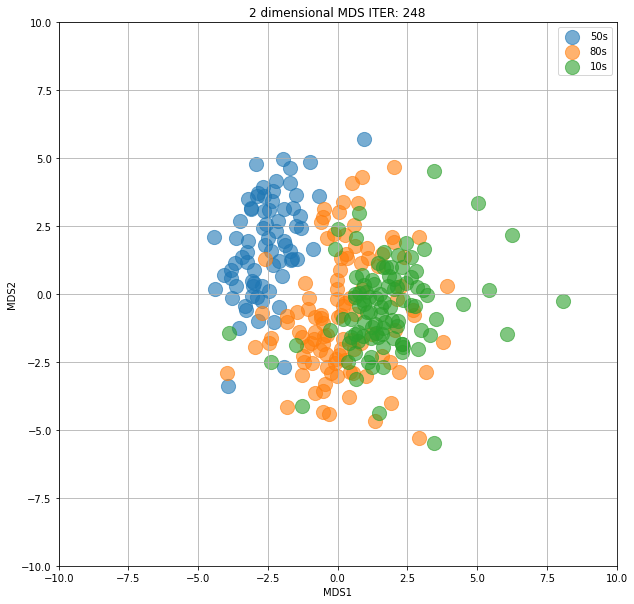

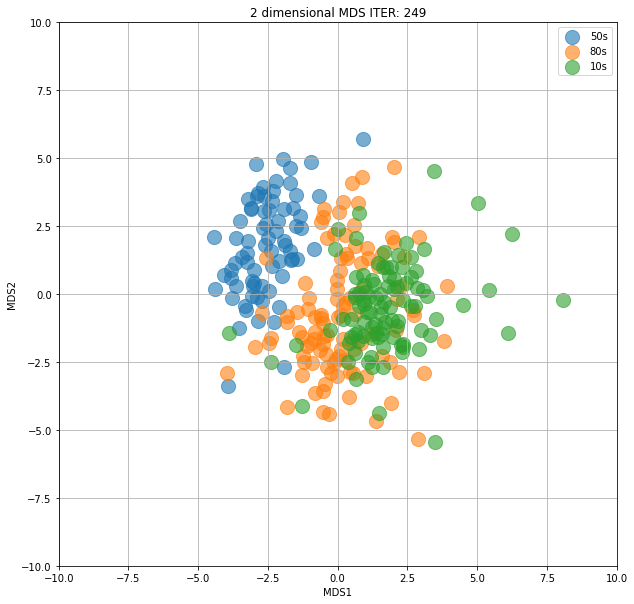

In [63]:
for i in range(1, 250):
    get_mds(i)

In [64]:
import cv2
import os
import re
image_folder = 'images'
video_name = 'video.avi'

images = [img for img in os.listdir(image_folder) if img.endswith(".png")]


In [65]:
images.sort(key=lambda var:[int(x) if x.isdigit() else x for x in re.findall(r'[^0-9]|[0-9]+', var)])

In [66]:
frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape

video = cv2.VideoWriter(video_name, 0, 1, (width,height))

for image in images:
    video.write(cv2.imread(os.path.join(image_folder, image)))

cv2.destroyAllWindows()
video.release()